In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import shutil
import cv2
import os
from tqdm import tqdm
import random

random.seed(42)

In [9]:
import timm
import torch

def gen_yolo_timm_config(model_name='seresnet50', input_size=640):
    model = timm.create_model(model_name, features_only=True, pretrained=False)
    dummy_input = torch.randn(1, 3, input_size, input_size)
    outputs = model(dummy_input)

    print(f"# Backbone config for timm model: {model_name}")
    print(f"- [-1, 1, Timm, [{outputs[-1].shape[1]}, '{model_name}', False, True, 0, True]]  # - 0")

    index_blocks = []
    for i, out in enumerate(outputs):
        c, h, w = out.shape[1:]
        index_blocks.append((i, c, h, w))

    # Auto-select last 3 outputs for P3, P4, P5
    selected = index_blocks[-3:]

    for idx, (i, c, h, w) in enumerate(selected):
        print(f"- [0, 1, Index, [{c}, {i}]]   # selects {i}th output (1, {c}, {w}, {h}) - {idx+1}")

    # SPPF
    sppf_in_channels = selected[-1][1]
    sppf_out_channels = sppf_in_channels // 2  # often reduced
    print(f"- [-1, 1, SPPF, [{sppf_out_channels}, 5]] # SPPF - {len(selected)+1}")

    # C2PSA
    print(f"- [-1, 2, C2PSA, [{sppf_out_channels}]]   # C2PSA - {len(selected)+2}")

gen_yolo_timm_config('efficientnet_b2', input_size=640)

# Backbone config for timm model: efficientnet_b2
- [-1, 1, Timm, [352, 'efficientnet_b2', False, True, 0, True]]  # - 0
- [0, 1, Index, [48, 2]]   # selects 2th output (1, 48, 80, 80) - 1
- [0, 1, Index, [120, 3]]   # selects 3th output (1, 120, 40, 40) - 2
- [0, 1, Index, [352, 4]]   # selects 4th output (1, 352, 20, 20) - 3
- [-1, 1, SPPF, [176, 5]] # SPPF - 4
- [-1, 2, C2PSA, [176]]   # C2PSA - 5


In [3]:
!git clone https://github.com/VA0211/mri_timm.git

Cloning into 'mri_timm'...
remote: Enumerating objects: 900, done.
remote: Counting objects: 100% (900/900), done.
remote: Compressing objects: 100% (688/688), done.
remote: Total 900 (delta 226), reused 874 (delta 200), pack-reused 0 (from 0)
Receiving objects: 100% (900/900), 2.00 MiB | 12.04 MiB/s, done.
Resolving deltas: 100% (226/226), done.


In [4]:
# %pip install ultralytics
%cd /kaggle/working/mri_timm
%pip install -e .
import ultralytics
ultralytics.checks()

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6170.1/8062.4 GB disk)


In [5]:
from ultralytics import YOLO

# Load a model
model = YOLO("/kaggle/working/mri_timm/ultralytics/cfg/models/11/11-resnet.yaml")

# Train the model
results = model.train(data="/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml", 
                      epochs=100,
                      patience=10,
                      imgsz=640,
                      pretrained=False,
                      device=0,
                      # batch=32,
                      # optimizer='AdamW',
                      # lr0=0.001,
                      # momentum=0.9,
                      )

WARNING ⚠️ no model scale passed. Assuming scale='s'.


model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

New https://pypi.org/project/ultralytics/8.3.102 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=/kaggle/working/mri_timm/ultralytics/cfg/models/11/11-resnet.yaml, data=/kaggle/input/brain-mri/Brain_Tumor_YOLO/brain_tumor.yaml, epochs=100, time=None, patience=10, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agno

100%|██████████| 755k/755k [00:00<00:00, 16.8MB/s]


Overriding model.yaml nc=80 with nc=3
WARNING ⚠️ no model scale passed. Assuming scale='s'.

                   from  n    params  module                                       arguments                     
  0                  -1  1  23508032  ultralytics.nn.modules.block.Timm            ['resnet50', True, True, 0, True]
  1                   0  1         0  ultralytics.nn.modules.conv.Index            [2]                           
  2                   0  1         0  ultralytics.nn.modules.conv.Index            [3]                           
  3                   0  1         0  ultralytics.nn.modules.conv.Index            [4]                           
  4                  -1  1   4197376  ultralytics.nn.modules.block.SPPF            [2048, 512, 5]                
  5                  -1  1    990976  ultralytics.nn.modules.block.C2PSA           [512, 512, 1]                 
  6                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']   

100%|██████████| 5.35M/5.35M [00:00<00:00, 69.3MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/train/labels... 1740 images, 442 backgrounds, 0 corrupt: 100%|██████████| 1740/1740 [00:09<00:00, 184.18it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/val/labels... 217 images, 55 backgrounds, 0 corrupt: 100%|██████████| 217/217 [00:01<00:00, 205.90it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/val is not writeable, cache not saved.
Plotting labels to /kaggle/working/mri_timm/runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 103 weight(decay=0.0), 110 weight(decay=0.0005), 109 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/mri_timm/runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      8.96G      3.156      5.569       3.72         14        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:05<00:00,  1.30it/s]

                   all        217        163      0.338      0.217      0.243     0.0791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      11.5G       2.45      3.211      2.698         12        640: 100%|██████████| 109/109 [01:11<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.483      0.442      0.419      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      11.5G      2.166      2.297      2.432         12        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.87it/s]

                   all        217        163      0.451      0.445      0.463      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      11.5G      2.013      1.883      2.268          8        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.586      0.604      0.608      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      11.5G       1.92      1.595      2.157         22        640: 100%|██████████| 109/109 [01:11<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.631      0.659      0.664      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      11.5G      1.853      1.433      2.106         20        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.676      0.657      0.743      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      11.5G      1.816      1.372      2.056         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.766      0.706      0.773      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      11.5G      1.786      1.311      2.036         12        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.773      0.776      0.832      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      11.5G      1.749      1.236      2.001         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.749      0.732      0.788      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      11.5G      1.728      1.149      1.976         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.791      0.788      0.826      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      11.5G      1.702      1.139       1.96         18        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.719      0.758      0.812      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      11.5G      1.696      1.091      1.954         21        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        217        163      0.825      0.751      0.825      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      11.5G      1.649      1.062      1.906         10        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        217        163       0.77      0.792      0.855      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      11.5G      1.645      1.031      1.886         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.877      0.736      0.828      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      11.5G      1.611      1.005      1.852         20        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        217        163      0.788        0.8       0.86       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      11.5G      1.602     0.9946      1.849         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.88it/s]

                   all        217        163      0.817      0.745      0.808      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      11.5G      1.553     0.9369      1.823         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.888      0.768      0.861      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      11.5G      1.552     0.9368      1.817         12        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        217        163      0.799      0.787      0.827       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      11.5G      1.516     0.9234      1.769         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.863      0.867      0.889      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      11.5G      1.498     0.8809      1.774         11        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.884      0.798      0.878      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      11.5G      1.472     0.8237      1.747         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.831      0.869        0.9      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      11.5G      1.448     0.8167      1.724          7        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.759      0.649      0.782      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      11.5G      1.433     0.8158      1.724         10        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.863      0.819      0.872      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      11.5G      1.404     0.7724       1.67         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.817      0.815      0.854      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      11.5G      1.403     0.7879       1.69         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.818      0.771      0.831      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      11.5G      1.366     0.7646      1.664         12        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163       0.85      0.823      0.865      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      11.5G      1.375     0.7855      1.673         10        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.833      0.745      0.833      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      11.5G       1.34     0.7545      1.617         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.818      0.825      0.859      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      11.5G      1.335     0.7437      1.634         17        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.816      0.889      0.887      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      11.5G      1.305      0.738      1.587         11        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.832      0.824       0.89      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      11.5G      1.294     0.7362      1.593         12        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        217        163      0.807      0.822      0.881      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      11.5G      1.304     0.7242      1.589         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.907      0.849      0.906       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      11.5G      1.215      0.677      1.524         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163       0.89      0.876      0.917      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      11.5G      1.208     0.6695      1.531         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.824      0.836      0.856      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      11.5G      1.231     0.6796      1.507         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.908      0.828      0.898      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      11.5G      1.195     0.6647      1.519         21        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.877      0.864      0.906      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      11.5G      1.138      0.633      1.468          8        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.865      0.897      0.922      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      11.5G      1.198     0.6502      1.502         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.913      0.847      0.908      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      11.5G      1.149     0.6178       1.46          6        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.886        0.8      0.863      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      11.5G      1.122     0.6232      1.454         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163       0.92      0.777      0.879      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      11.5G      1.115     0.6199       1.44         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.873      0.896      0.919       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      11.5G      1.085     0.5981      1.417         18        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.852      0.891      0.897       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      11.5G      1.078     0.5892       1.41         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.902      0.789      0.891      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      11.5G      1.072     0.5907      1.402         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.89it/s]

                   all        217        163      0.872      0.826      0.893      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      11.5G      1.075     0.5942      1.416         17        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.942      0.792      0.913      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      11.5G      1.071     0.6036      1.403         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.922      0.861      0.919      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      11.5G      1.025     0.5689      1.357         11        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.898      0.862      0.909      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      11.5G      1.012     0.5599      1.357         20        640: 100%|██████████| 109/109 [01:11<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.884      0.878      0.923      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      11.5G      1.019     0.5606      1.373         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.886      0.844      0.897      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      11.5G      1.017      0.558      1.359         19        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.90it/s]

                   all        217        163      0.874      0.873      0.921      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      11.5G      1.008     0.5579      1.344          9        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.902      0.855      0.884      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      11.5G     0.9774      0.546      1.338         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.882      0.826      0.879       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      11.5G     0.9682     0.5378      1.316         21        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.854      0.907      0.914      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      11.5G     0.9605     0.5383       1.32         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.91it/s]

                   all        217        163      0.888      0.873      0.914      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      11.5G     0.9541     0.5253      1.304         15        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.956      0.846      0.922      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      11.5G     0.9434     0.5231      1.279         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163       0.88      0.859      0.896      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      11.5G     0.9405     0.5244      1.295         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.902      0.891      0.937      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      11.5G     0.9197     0.5053      1.293         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.923      0.873      0.934      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      11.5G     0.9013     0.5016      1.266         12        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.912       0.86      0.923      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      11.5G     0.8908      0.496      1.253         24        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.903      0.829      0.916      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      11.5G     0.8916     0.5051      1.261          8        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.884       0.88      0.931      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      11.5G      0.895     0.5031       1.26         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.878      0.859      0.913      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      11.5G     0.8915     0.5004      1.257         18        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.923      0.862      0.924      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      11.5G     0.8742     0.4932      1.258         13        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.878      0.868      0.918      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      11.5G     0.8513     0.4949      1.246         12        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.889      0.859      0.911      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      11.5G     0.8785     0.4966      1.258         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.891      0.872      0.913      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      11.5G      0.864     0.4849      1.251          8        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.892      0.884        0.9      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      11.5G     0.8541     0.4843      1.228         19        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.889      0.902      0.927      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      11.5G     0.8514     0.4774      1.223         11        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.896      0.841       0.91      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      11.5G     0.8252     0.4728      1.204         20        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.904      0.863      0.911      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      11.5G      0.808     0.4482      1.195         14        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.908      0.873      0.925      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      11.5G     0.8208     0.4602      1.198         11        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.908      0.879       0.93      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      11.5G     0.8066     0.4611      1.201         18        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.892      0.888      0.937      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      11.5G      0.801     0.4513      1.185         23        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.878      0.882      0.925       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      11.5G     0.7838     0.4549      1.172         12        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.923      0.852      0.926      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      11.5G     0.7864     0.4472      1.187         17        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.883      0.891      0.917      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      11.5G     0.7931     0.4514      1.191         12        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.902      0.876      0.919      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      11.5G     0.7734     0.4539      1.171         15        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.898      0.876      0.931       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      11.5G     0.7628     0.4342      1.172         16        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.899      0.849      0.911      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      11.5G     0.7541     0.4355      1.159         20        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.898      0.857      0.919      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      11.5G     0.7508     0.4338      1.152         17        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]

                   all        217        163      0.922      0.861      0.919      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.5G     0.7498      0.432      1.168          9        640: 100%|██████████| 109/109 [01:10<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.885       0.88       0.93       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      11.5G     0.7556     0.4281      1.154         10        640: 100%|██████████| 109/109 [01:11<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        217        163      0.916      0.843      0.917      0.506
EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 75, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



85 epochs completed in 1.788 hours.
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/last.pt, 66.3MB
Optimizer stripped from /kaggle/working/mri_timm/runs/detect/train/weights/best.pt, 66.3MB

Validating /kaggle/working/mri_timm/runs/detect/train/weights/best.pt...
Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11-resnet summary: 260 layers, 32,901,753 parameters, 0 gradients, 82.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.74it/s]


                   all        217        163      0.892      0.888      0.937      0.518
             pituitary         62         63      0.931      0.937      0.963       0.51
            meningioma         55         55      0.894      0.964      0.973      0.584
                glioma         45         45      0.852      0.765      0.873      0.458


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 14.3ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train


In [6]:
val_results = model.val(split='test')

Ultralytics 8.3.101 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
11-resnet summary: 260 layers, 32,901,753 parameters, 0 gradients, 82.0 GFLOPs


val: Scanning /kaggle/input/brain-mri/Brain_Tumor_YOLO/test/labels... 218 images, 55 backgrounds, 0 corrupt: 100%|██████████| 218/218 [00:00<00:00, 220.63it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/brain-mri/Brain_Tumor_YOLO/test is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:07<00:00,  1.78it/s]


                   all        218        164      0.924      0.878      0.921      0.511
             pituitary         62         62      0.953      0.974      0.991      0.483
            meningioma         55         55      0.995      0.964      0.994      0.636
                glioma         46         47      0.824      0.696       0.78      0.413


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 1.5ms preprocess, 30.1ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /kaggle/working/mri_timm/runs/detect/train2


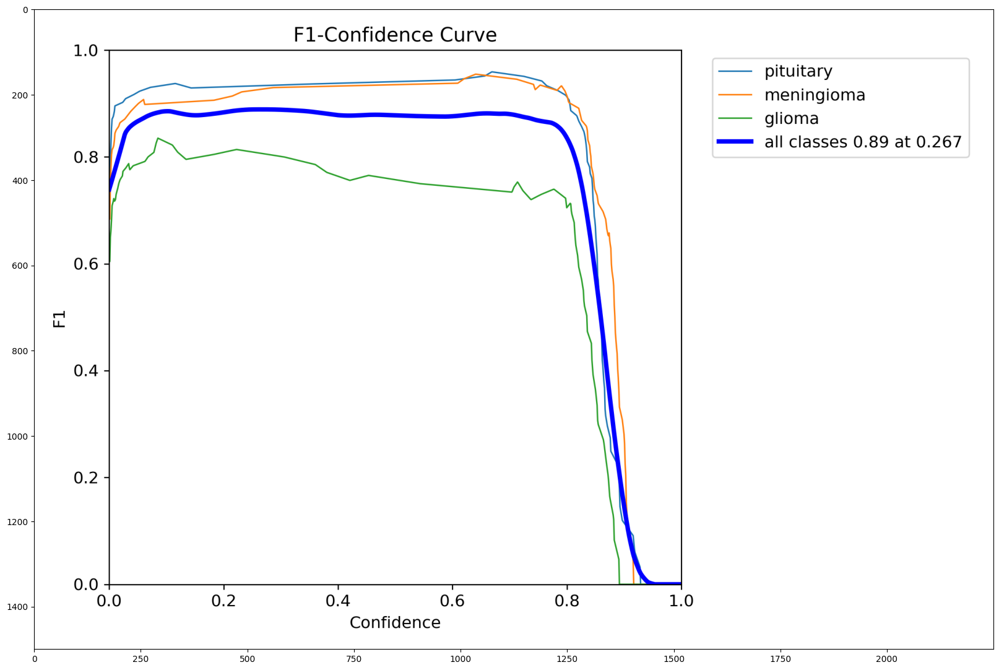

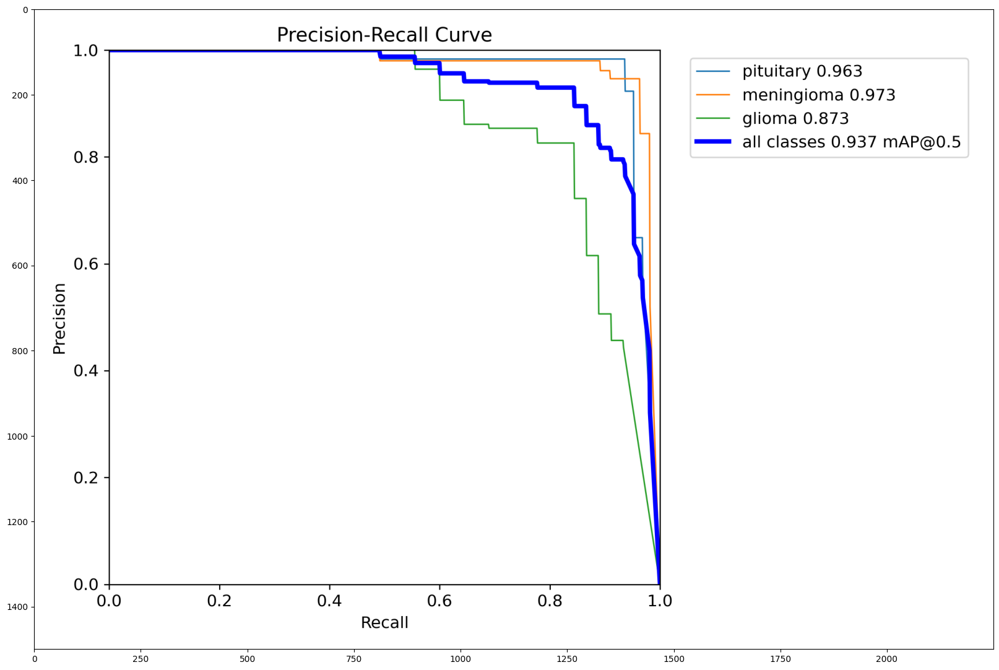

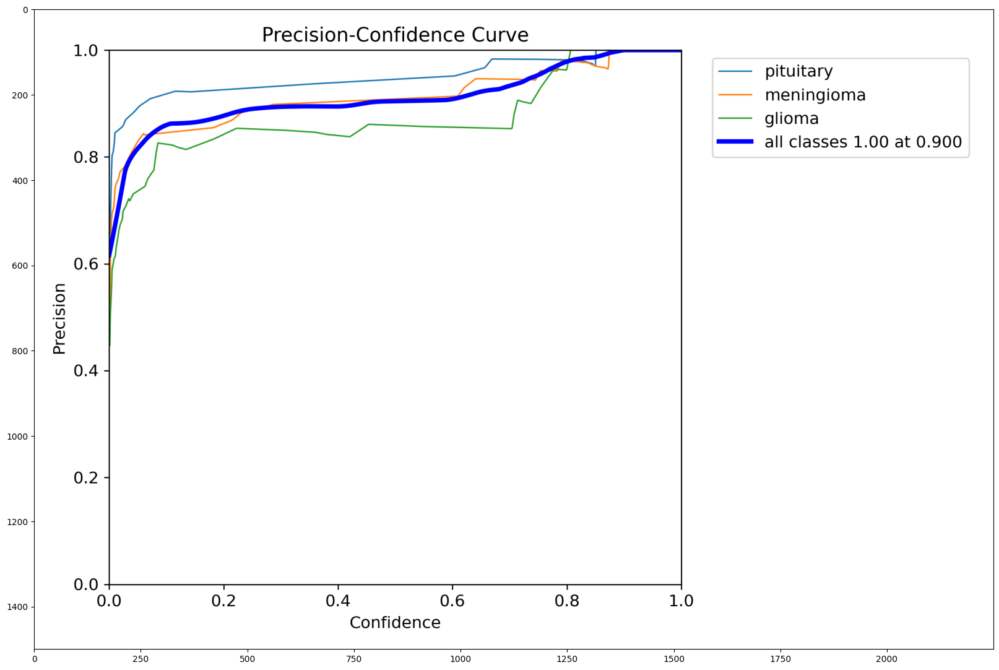

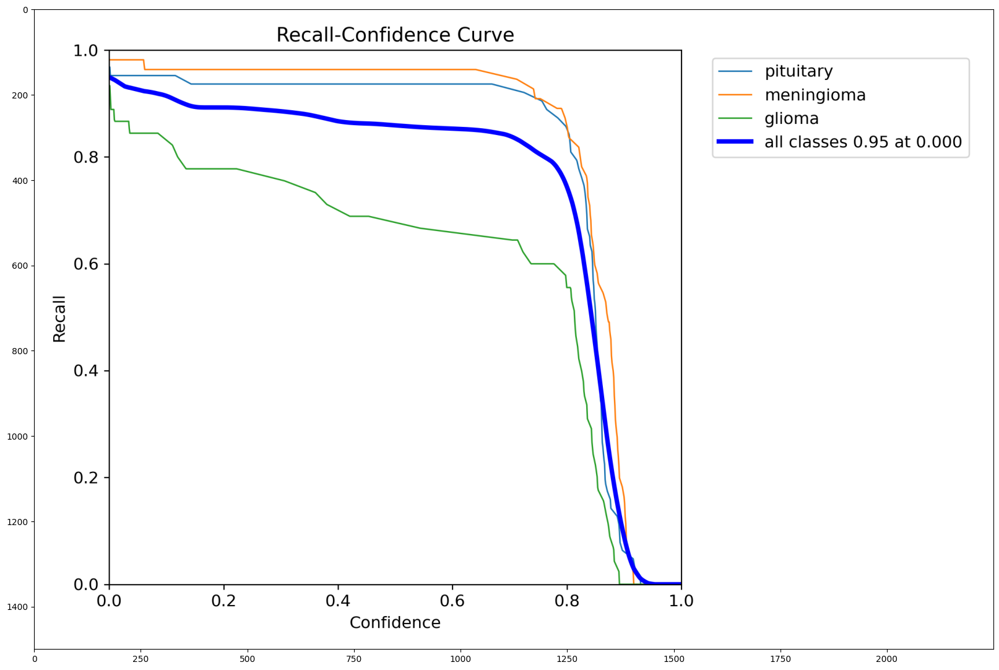

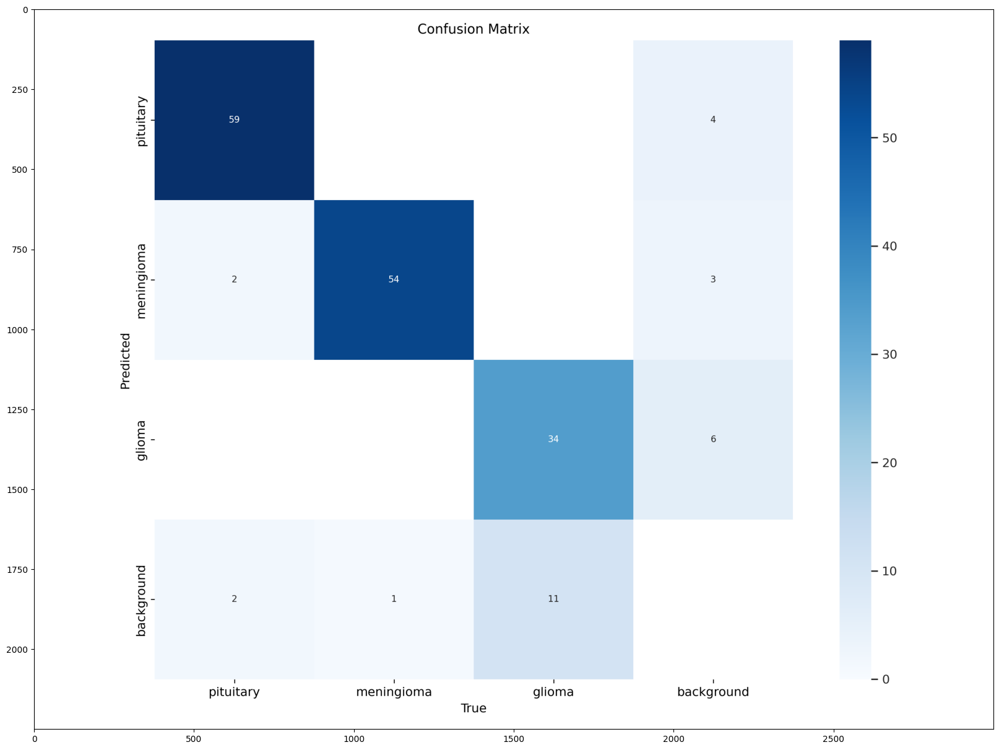

...

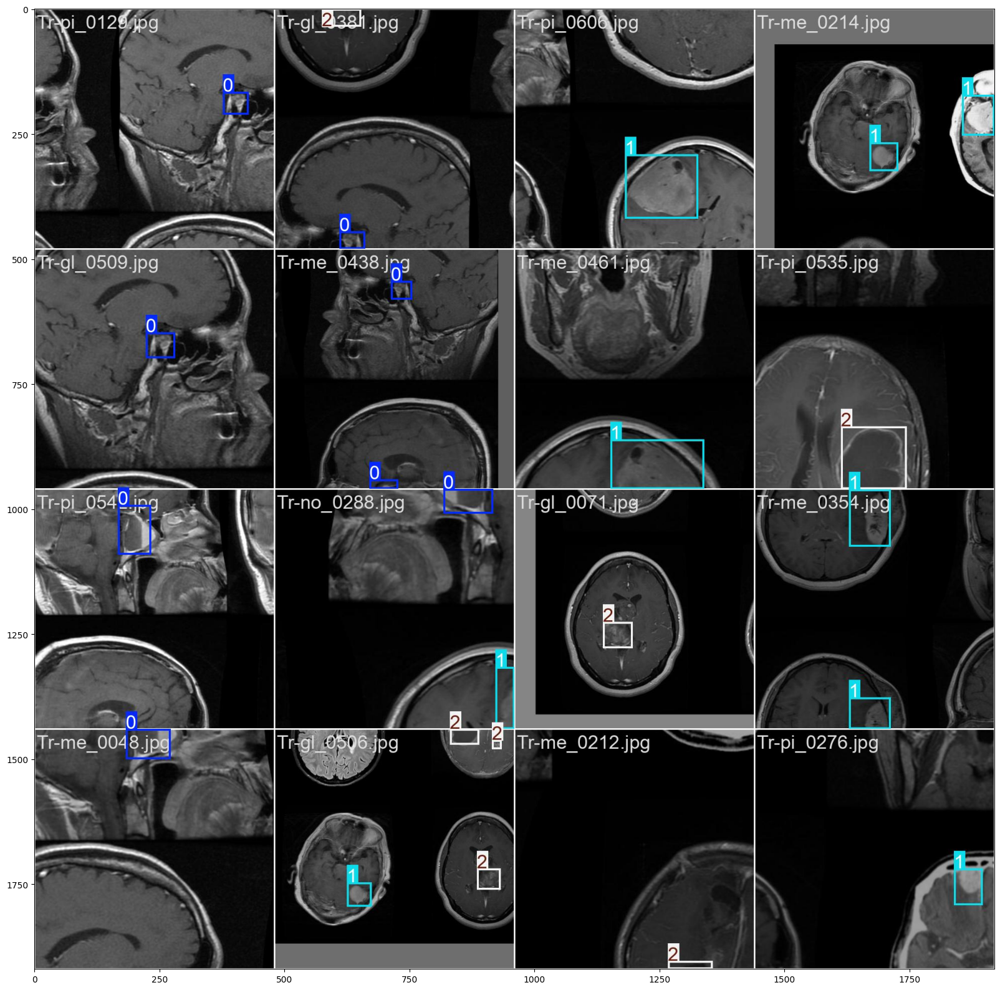

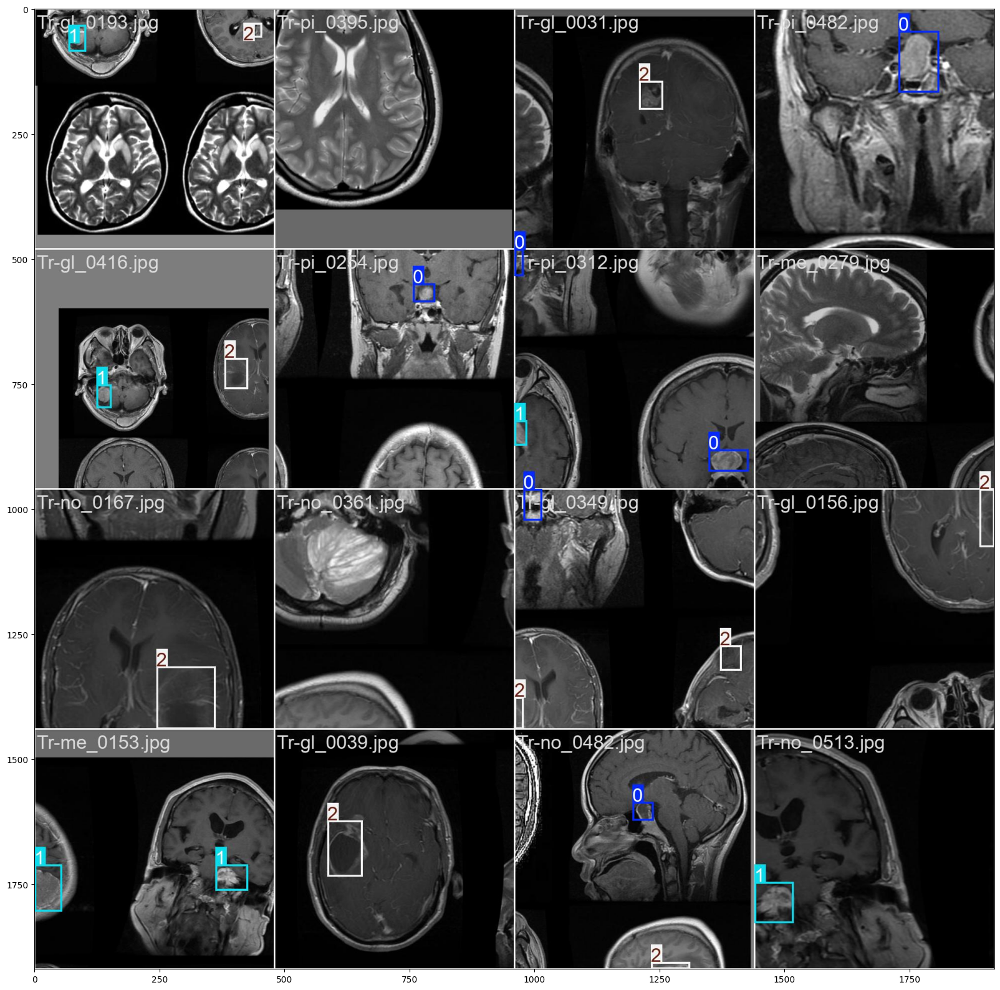

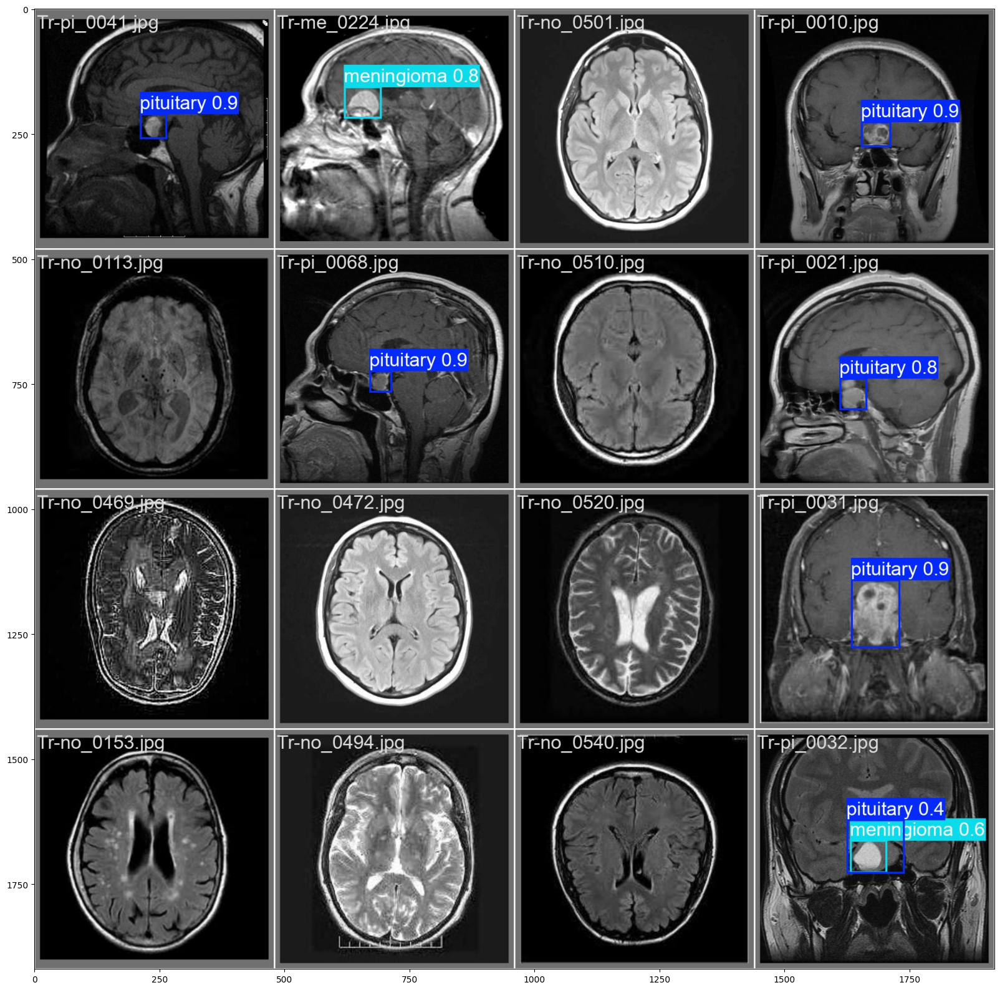

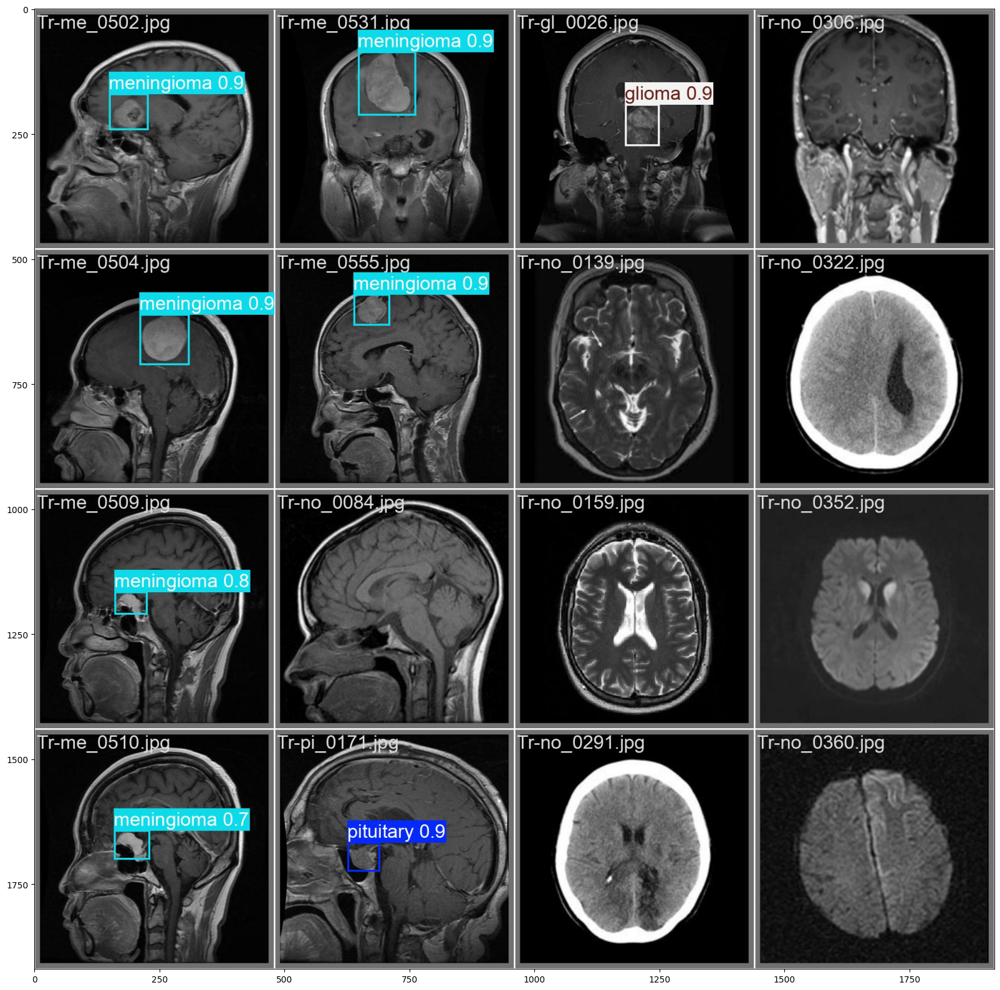

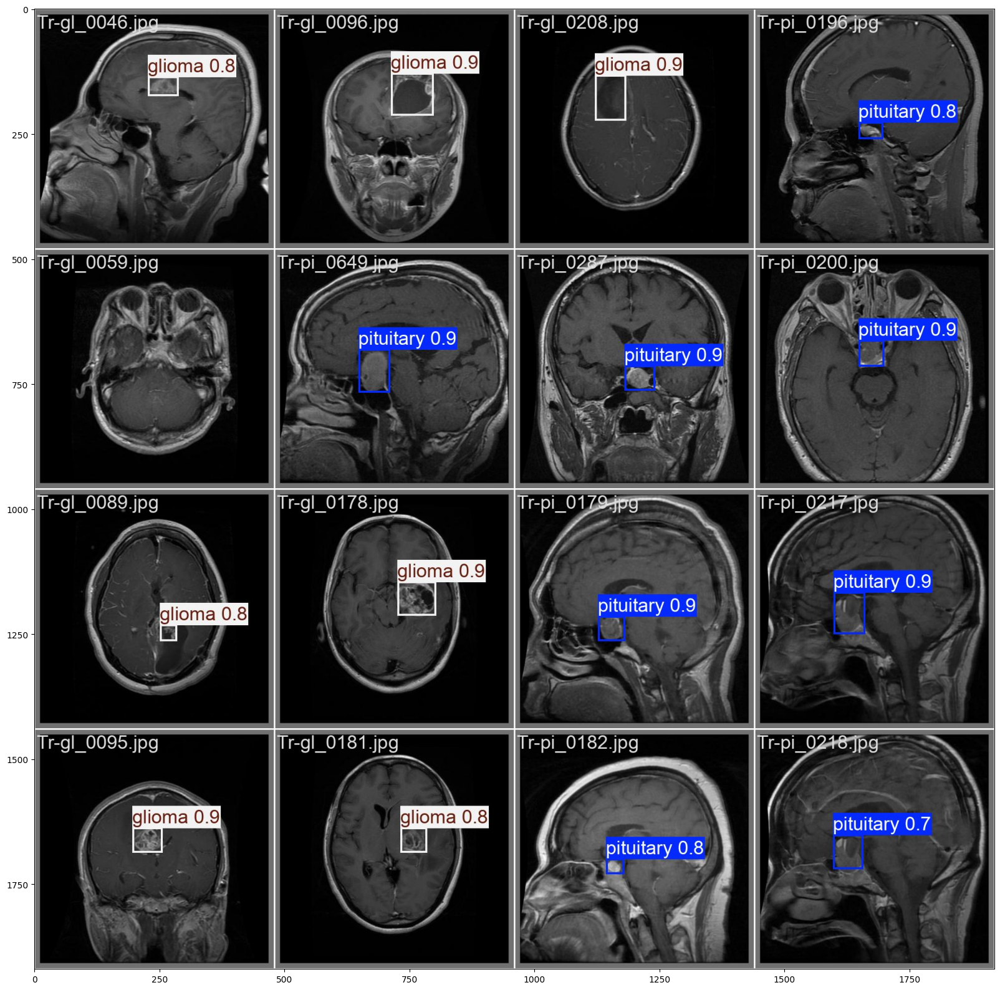

In [7]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train/*.jpg')):
    if not path.split('.')[0].endswith('_labels') or path.split('.')[0].startswith('train_'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()

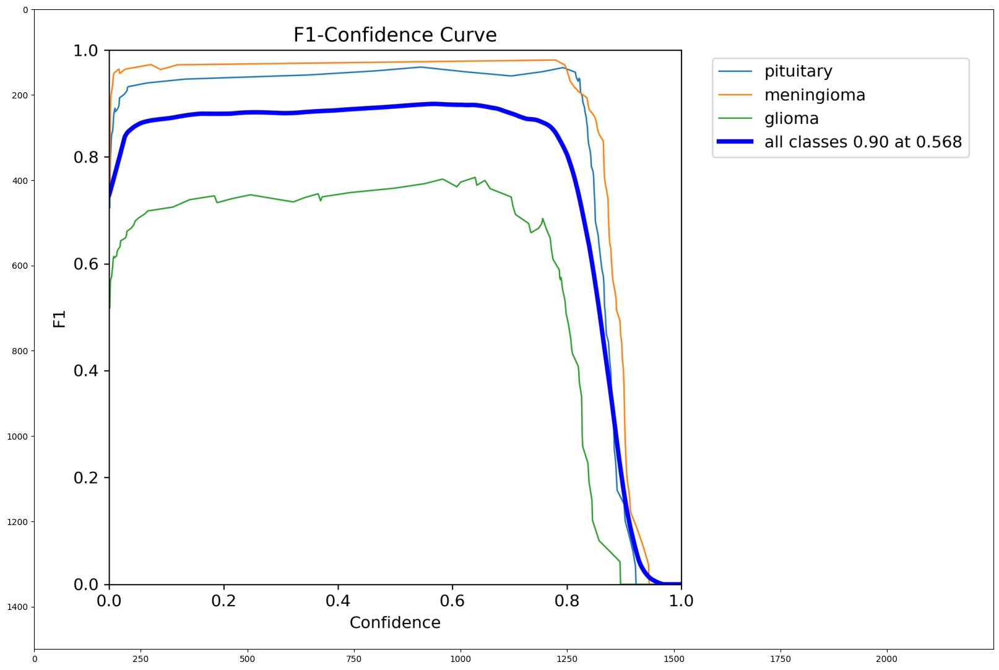

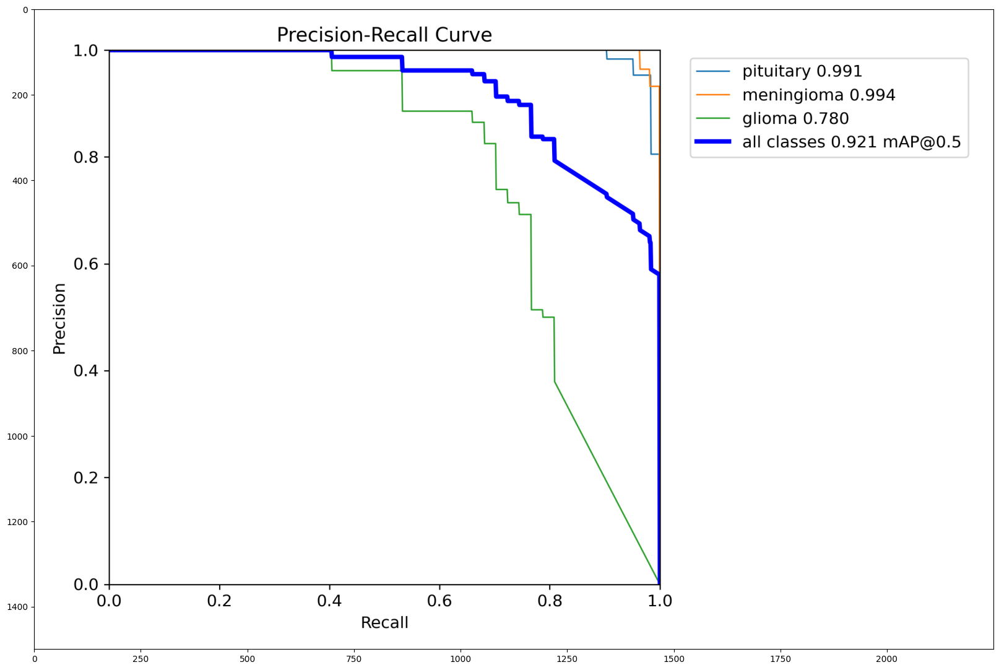

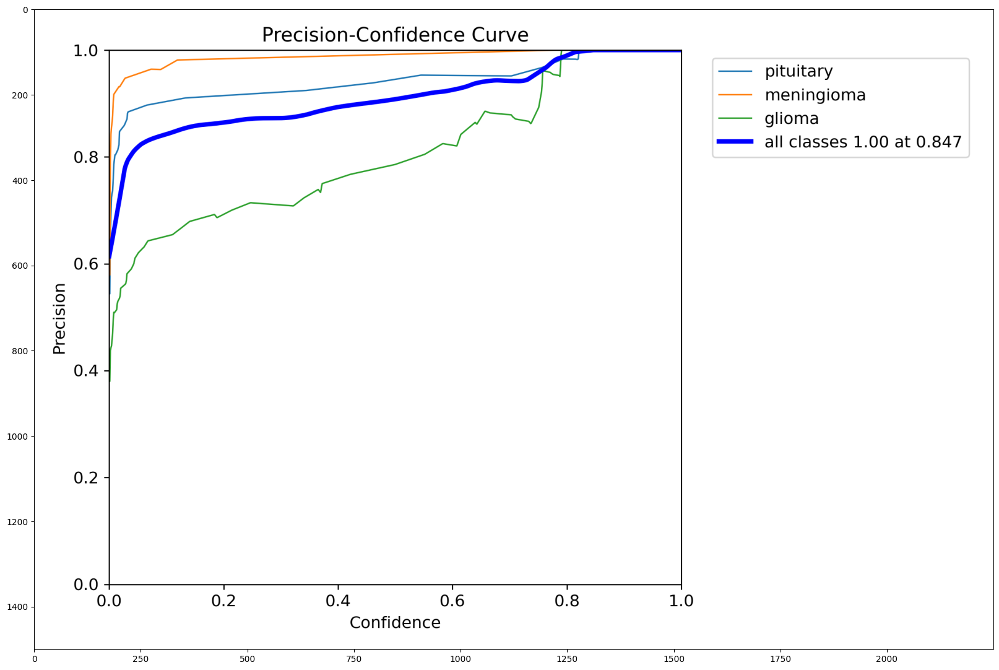

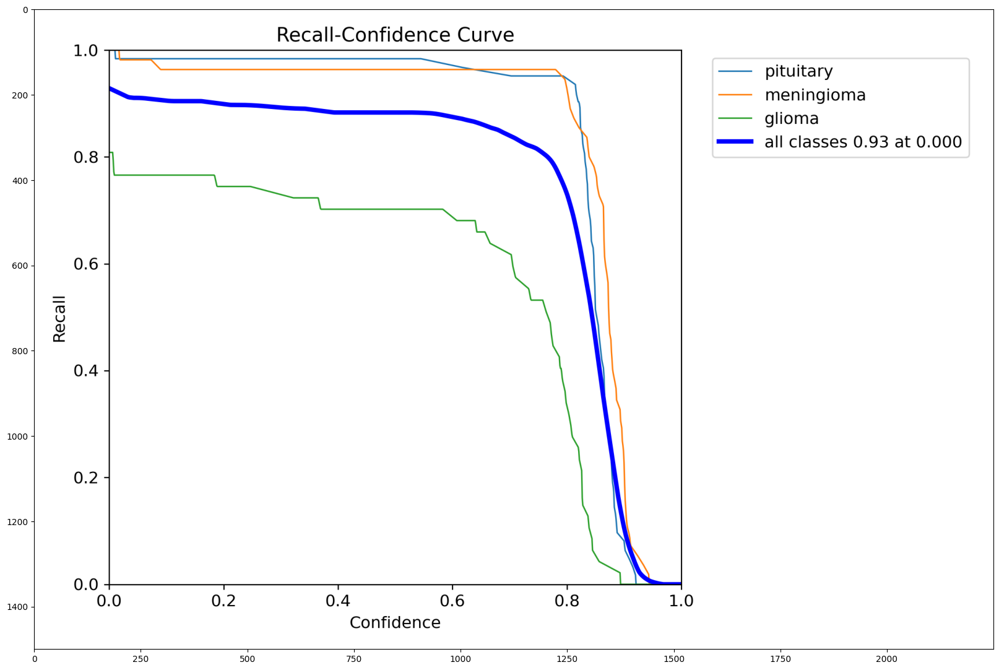

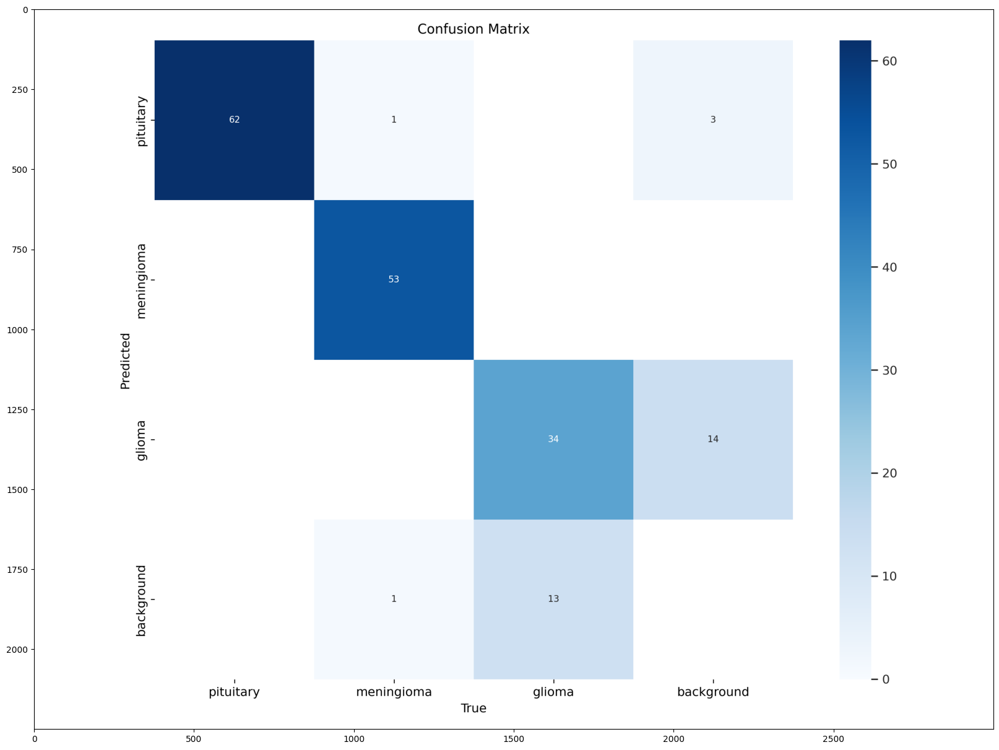

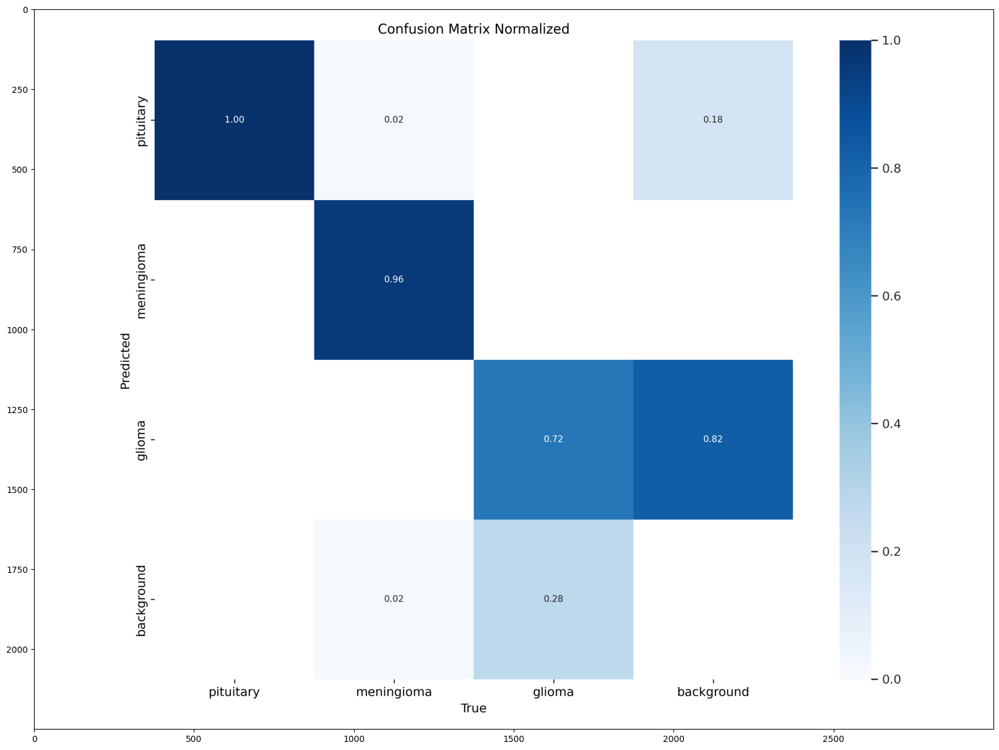

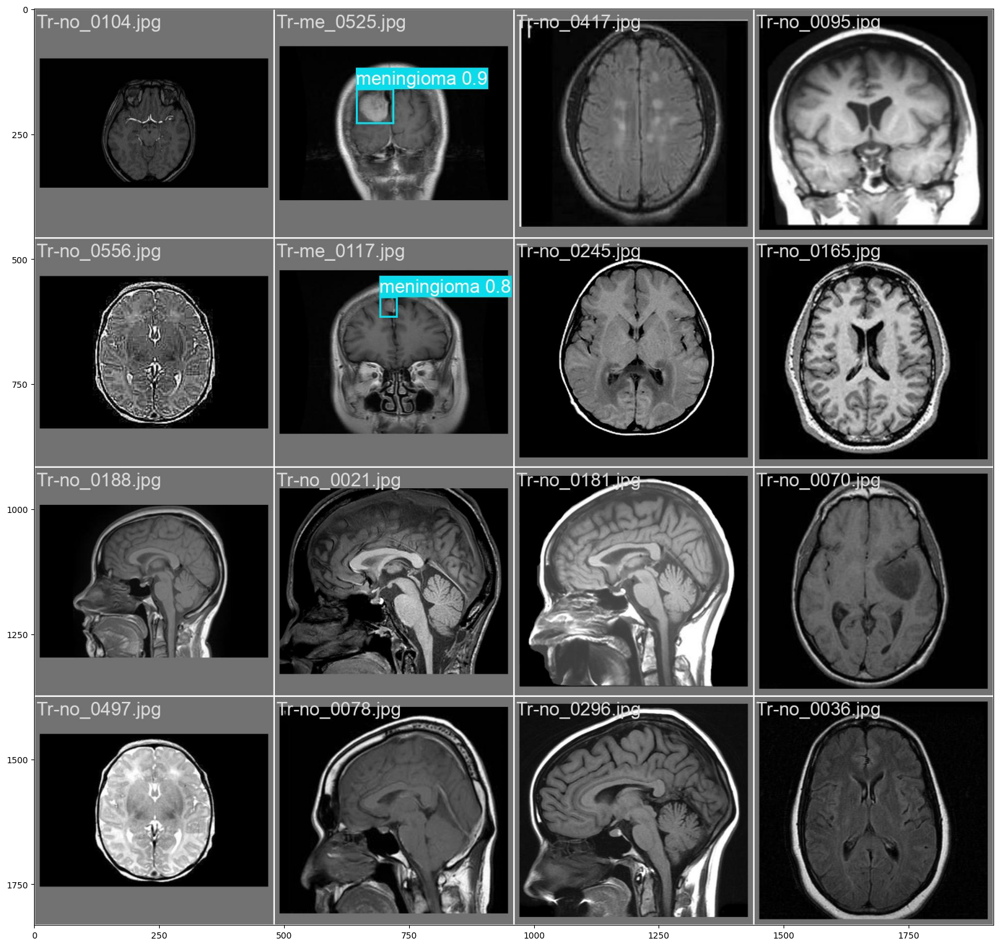

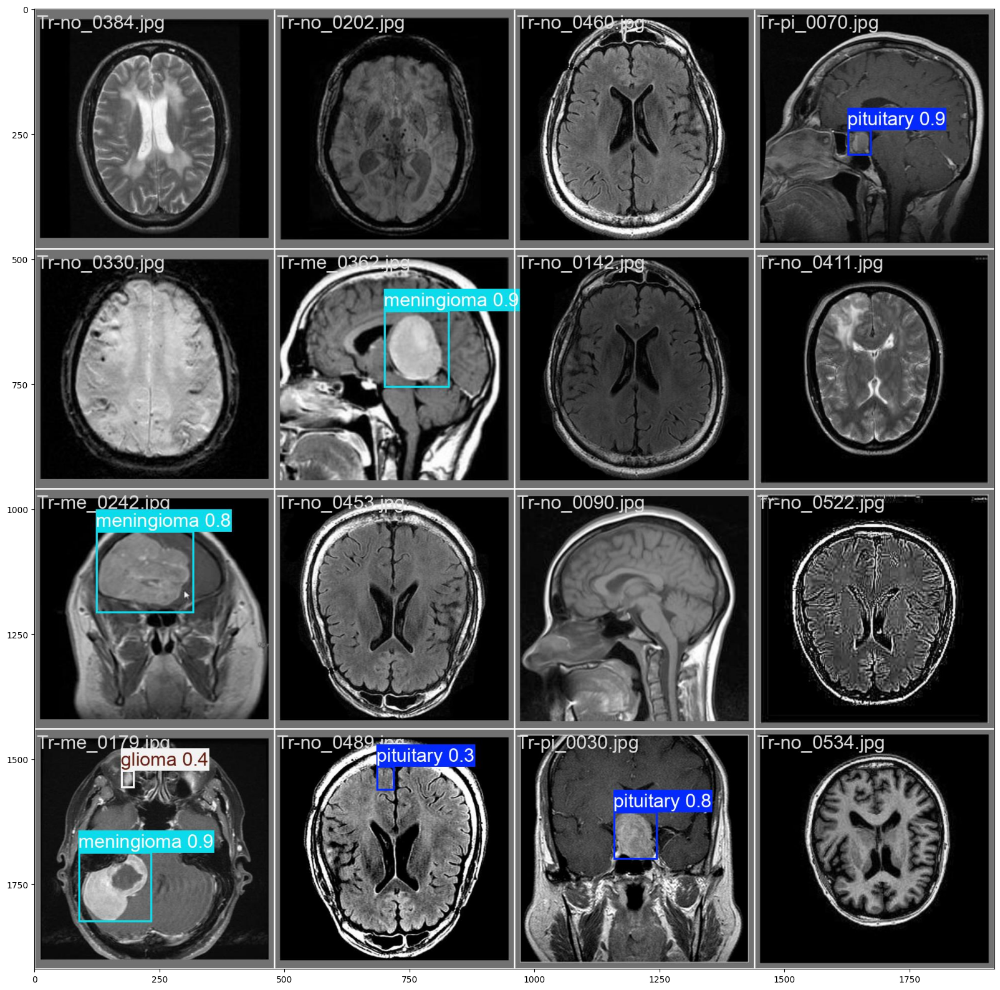

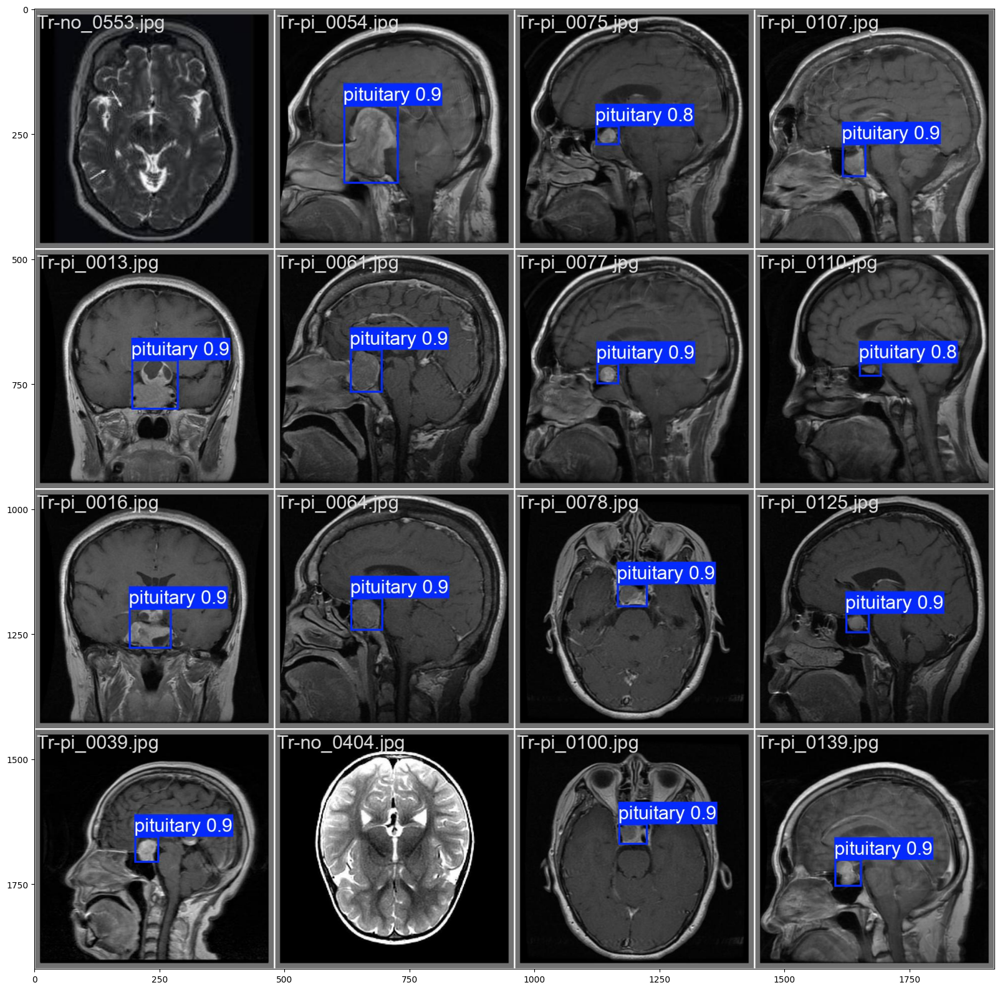

In [8]:
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.png')):
    image = cv2.imread(path)[:,:,::-1]
    plt.figure(figsize=(20,20))
    plt.imshow(image)
    plt.show()
    
for path in sorted(glob.glob('/kaggle/working/mri_timm/runs/detect/train2/*.jpg')):
    if not path.split('.')[0].endswith('_labels'): 
        image = cv2.imread(path)[:,:,::-1]
        plt.figure(figsize=(20,20))
        plt.imshow(image)
        plt.show()